In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.io.sas.sas_constants import dataset_length
from scipy.stats import gaussian_kde
#import plotly.graph_objects as go
from IPython.display import clear_output
from matplotlib import cm

def assign_shift(hour):
    if 0 <= hour < 8:
        return 'Morning'
    elif 8 <= hour < 16:
        return 'Afternoon'
    else:
        return 'Night'


dataset_v1 = pd.read_csv('C://Users//amjads//Documents//Data_extract//Clinical_deterioration//obs_test.csv', delimiter = ",", encoding='ISO-8859-1')
dataset_v1.rename(columns={'»¿PAT_ENC_CSN_ID':'PAT_ENC_CSN_ID'},inplace=True)

In [6]:
# Convert the 'datetime_str' column to datetime with a specified format
dataset_v1['entry_dt'] = pd.to_datetime(dataset_v1['ENTRY_TIME'], format='%Y-%m-%d %H:%M:%S.%f')

# Generate 'hour' and 'day' columns
dataset_v1['hour'] = dataset_v1['entry_dt'].dt.hour
dataset_v1['day'] = dataset_v1['entry_dt'].dt.day

dataset_v1['MEAS_VALUE'] = (dataset_v1['MEAS_VALUE'] - 32) * (5/9)

# Apply the function to the dt.hour column
dataset_v1['Shift'] = dataset_v1['hour'].apply(assign_shift)

shift_counts = dataset_v1['Shift'].value_counts()

In [405]:
df_filtered = pd.DataFrame()
df_filtered = dataset_v1.copy()
df_filtered.shape

(262960, 7)

In [ ]:
df = pd.DataFrame()
df = dataset_v1.copy()

In [51]:
df.shape

(262960, 7)

In [8]:
multiplier = 3.0

# Calculate Q1 (25th percentile) and Q3 (75th percentile) for MEAS_VALUE
Q1 = df['MEAS_VALUE'].quantile(0.25)
Q3 = df['MEAS_VALUE'].quantile(0.75)

# Calculate the IQR
IQR = Q3 - Q1

# Determine the upper and lower bounds
lower_bound = Q1 - multiplier * IQR
upper_bound = Q3 + multiplier * IQR

# Filter the dataframe to remove outliers
df_filtered = df[(df['MEAS_VALUE'] >= lower_bound) & (df['MEAS_VALUE'] <= upper_bound)]

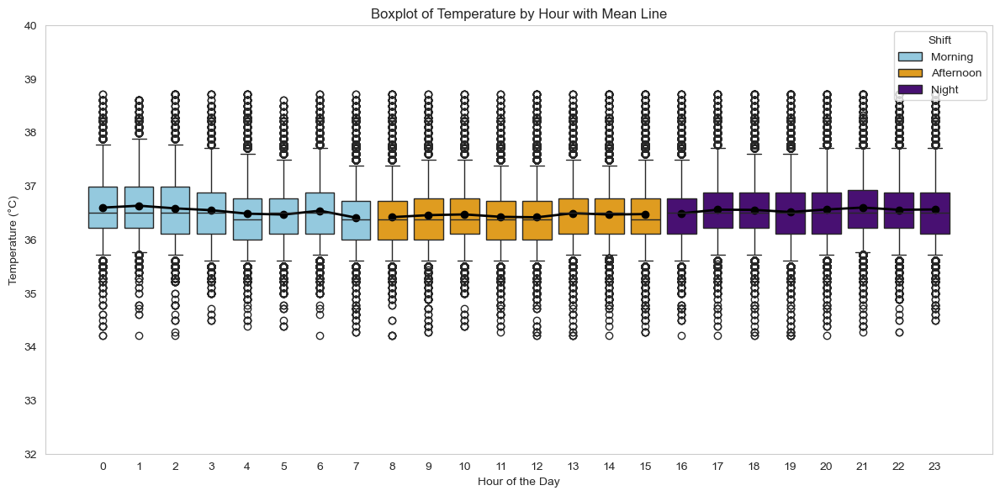

In [9]:
# Print or use df_filtered for further analysis or plotting
# print(df_filtered)
dataframe = df_filtered.loc[:,:]
# Create a figure
plt.figure(figsize=(12, 6))

dataframe = dataframe.dropna(subset=['MEAS_VALUE'])
# Ensure 'hour' column has valid integers
dataframe['hour'] = dataframe['hour'].round().astype(int)

# Safely round temperature values using .loc[]
dataframe.loc[:, 'MEAS_VALUE'] = dataframe['MEAS_VALUE'].round(3)

# Create a boxplot
sns.boxplot(x='hour', y='MEAS_VALUE', hue='Shift', data=dataframe,
            palette={'Morning': '#87CEEB', 'Afternoon': '#FFA500', 'Night': '#4B0082'},
            dodge=False, whis=[5, 95]) # Dodge=False to overlay boxplots

# Overlay a line plot for each shift
for shift in dataframe['Shift'].unique():
    shift_data = dataframe[dataframe['Shift'] == shift].groupby('hour')['MEAS_VALUE'].mean()
    plt.plot(shift_data.index, shift_data.values, marker='o', linewidth=2
             #,label=f'Mean Temperature - {shift}'
             , color = 'Black')
                                                     #color={
                                                    #'Morning': '#87CEEB',
                                                     #    'Afternoon': '#FFA500',
                                                      # 'Night': '#4B0082'}[shift])

# Set a fixed y-axis range to ensure consistency
plt.ylim(32, 40)

# Adding titles and labels
plt.title('Boxplot of Temperature by Hour with Mean Line')
plt.xlabel('Hour of the Day')
plt.ylabel('Temperature (°C)')

# Show legend
plt.legend(title='Shift', loc='upper right')

# Show grid
plt.grid(axis='y')

# Show the plot
plt.tight_layout()
plt.show()

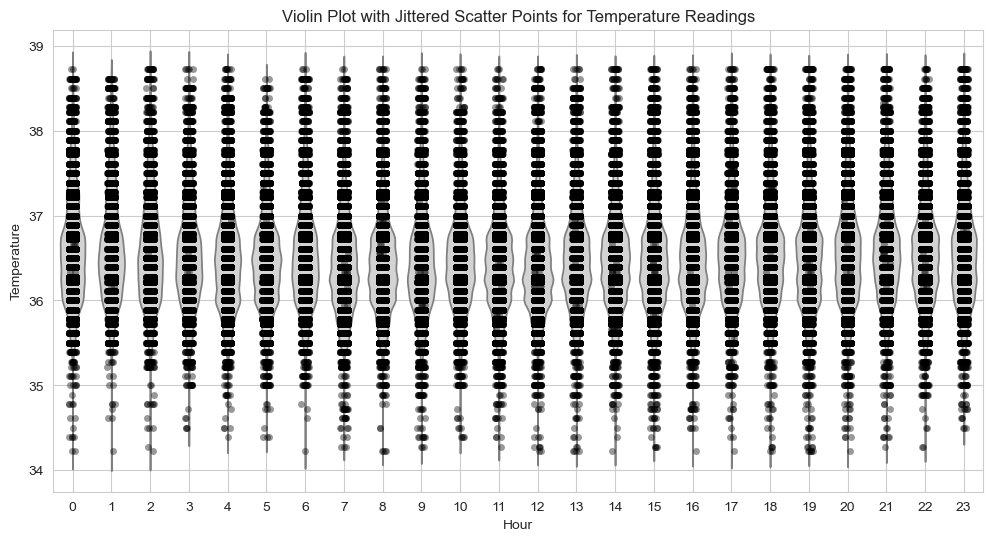

In [19]:
plt.close()
plt.figure(figsize=(12, 6))
sns.violinplot(x='hour', y='MEAS_VALUE', data=dataframe, inner=None, color='lightgray')
sns.stripplot(x='hour', y='MEAS_VALUE', data=dataframe, color='black', alpha=0.4, jitter=True)

# Customize the plot
plt.title('Violin Plot with Jittered Scatter Points for Temperature Readings')
plt.xlabel('Hour')
plt.ylabel('Temperature')
plt.grid(True)
plt.show()

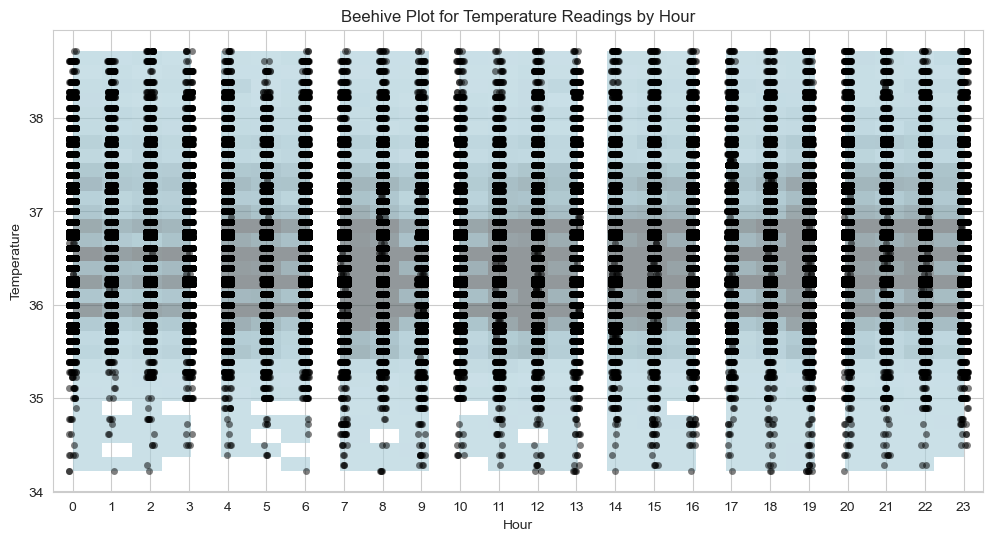

In [36]:
plt.close()
plt.figure(figsize=(12, 6))
# Create the beehive plot
sns.histplot(data=dataframe, x='hour', y='MEAS_VALUE', bins=30, pmax=0.5, color='lightblue',kde=False, alpha=0.6)

# Add jitter for individual points
sns.stripplot(data=dataframe, x='hour', y='MEAS_VALUE', color='black', alpha=0.5, jitter=True)

# Customize the plot
plt.title('Beehive Plot for Temperature Readings by Hour')
plt.xlabel('Hour')
plt.ylabel('Temperature')
plt.grid(True)
plt.show()

In [45]:
print(dataframe['hour'].unique())

[10 12 11 14  8 20 13  9 18 19 17  7 16 15  6 23  2 22  5  4  3 21  0  1]


<Figure size 1200x600 with 0 Axes>

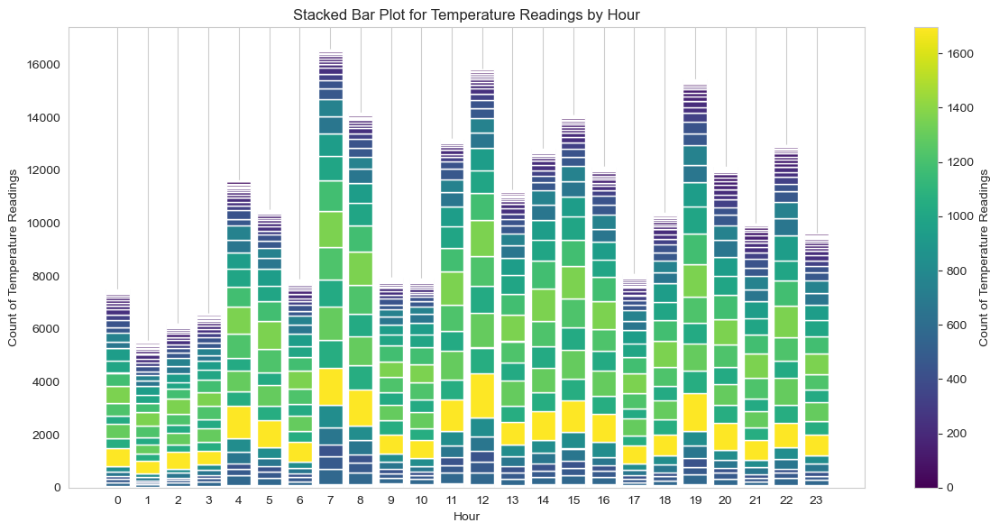

In [50]:
plt.close()
plt.figure(figsize=(12, 6))

# Filter valid hours
dataframe = dataframe[(dataframe['hour'] >= 0) & (dataframe['hour'] <= 23)]

# Group the data
counts = dataframe.groupby(['hour', 'MEAS_VALUE']).size().reset_index(name='Count')

# Pivot the data for easier plotting
pivot_counts = counts.pivot(index='hour', columns='MEAS_VALUE', values='Count').fillna(0)

# Create the figure and axes
fig, ax = plt.subplots(figsize=(12, 6))

# Normalize the counts for color mapping
norm = plt.Normalize(pivot_counts.values.min(), pivot_counts.values.max())
cmap = cm.viridis  # Choose a colormap

# Plot stacked bars with color mapping
bottoms = np.zeros(len(pivot_counts.index))
for meas_value in pivot_counts.columns:
    color = cmap(norm(pivot_counts[meas_value].max()))  # Use the max count for color
    ax.bar(pivot_counts.index, pivot_counts[meas_value], bottom=bottoms,
           color=color)  # Removed label here
    bottoms += pivot_counts[meas_value].values

# Create a color bar for the gradient
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Specify the axes for the colorbar
cbar = plt.colorbar(sm, ax=ax, label='Count of Temperature Readings')

# Customize the plot
ax.set_title('Stacked Bar Plot for Temperature Readings by Hour')
ax.set_xlabel('Hour')
ax.set_ylabel('Count of Temperature Readings')
ax.set_xticks(np.arange(len(pivot_counts.index)))
ax.set_xticklabels(pivot_counts.index)

# Set y-limits if necessary
ax.set_ylim(bottom=0)  # Adjust as needed

ax.grid(axis='y')
plt.tight_layout()
# Removed the legend to prevent duplication
plt.show()

In [ ]:
plt.figure(figsize=(12, 6))
# Create a KDE plot for density estimation
sns.kdeplot(data=dataframe, x='hour', y='MEAS_VALUE', fill=True, thresh=0, levels=20, cmap='viridis', alpha=0.5)

# Overlay individual data points with jitter
#sns.stripplot(data=df, x='hour', y='MEAS_VALUE', color='black', alpha=0.6, jitter=True)

# Customize the plot
plt.title('Beehive-like Plot for Temperature Readings by Hour')
plt.xlabel('Hour')
plt.ylabel('Temperature')
plt.grid(True)
plt.show()

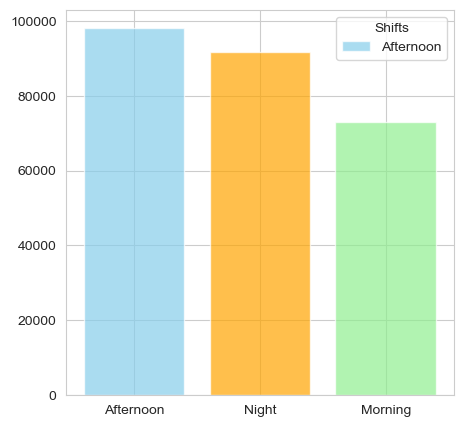

In [167]:
plt.close()
plt.figure(figsize=(5,5))
# Create a bar plot for each shift
plt.bar(shift_counts.index, shift_counts.values, color=['skyblue', 'orange', 'lightgreen'], alpha=0.7)

#plt.xlabel('Actual time (minutes)')
#plt.ylabel('Predicted time (minutes)')
#plt.title('XGBoost Results')
plt.legend(title="Shifts", labels = ["Afternoon", "Night", "Morning"])

plt.show()

In [223]:
df = dataset_v1.copy()

In [169]:
df.shape

(262960, 7)

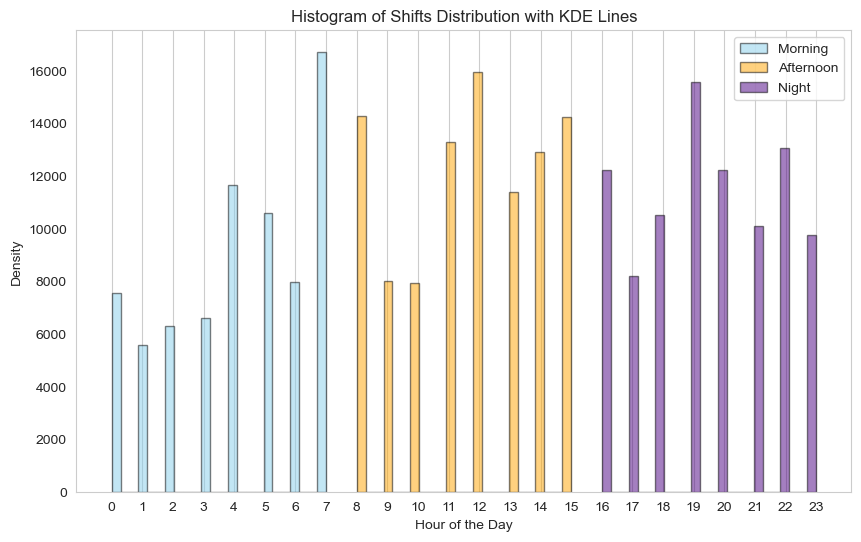

In [174]:
# Prepare data for histogram
# Prepare data for histogram
shifts = {
    'Morning': df[df['Shift'] == 'Morning']['hour'],
    'Afternoon': df[df['Shift'] == 'Afternoon']['hour'],
    'Night': df[df['Shift'] == 'Night']['hour']
}

# Define colors for each shift
colors = {
    'Morning': '#87CEEB',  # Light Sky Blue
    'Afternoon': '#FFA500',  # Orange
    'Night': '#4B0082'      # Indigo
}
# Plotting
#plt.close()
plt.figure(figsize=(10, 6))

# Loop through shifts to create histograms
for shift, hours in shifts.items():
    plt.hist(hours, bins=24, alpha=0.5, label=shift, color=colors[shift], edgecolor='black')
    # Fit a KDE line using scipy
    kde = gaussian_kde(hours)
    x = np.linspace(0, 23, 100)  # Create a range of x values
    #plt.plot(x, kde(x), color=colors[shift], linewidth=2, linestyle='--', label=f'{shift} KDE')

# Adding titles and labels
plt.title('Histogram of Shifts Distribution with KDE Lines')
plt.xlabel('Hour of the Day')
plt.ylabel('Density')
plt.xticks(range(24))  # Show each hour on the x-axis

# Show legend
plt.legend(loc='upper right')

# Show grid
plt.grid(axis='y')

# Show the plot
#plt.tight_layout()
plt.show()

In [188]:
df.columns

Index(['ï»¿PAT_ENC_CSN_ID', 'ENTRY_TIME', 'MEAS_VALUE', 'entry_dt', 'hour',
       'day', 'Shift'],
      dtype='object')

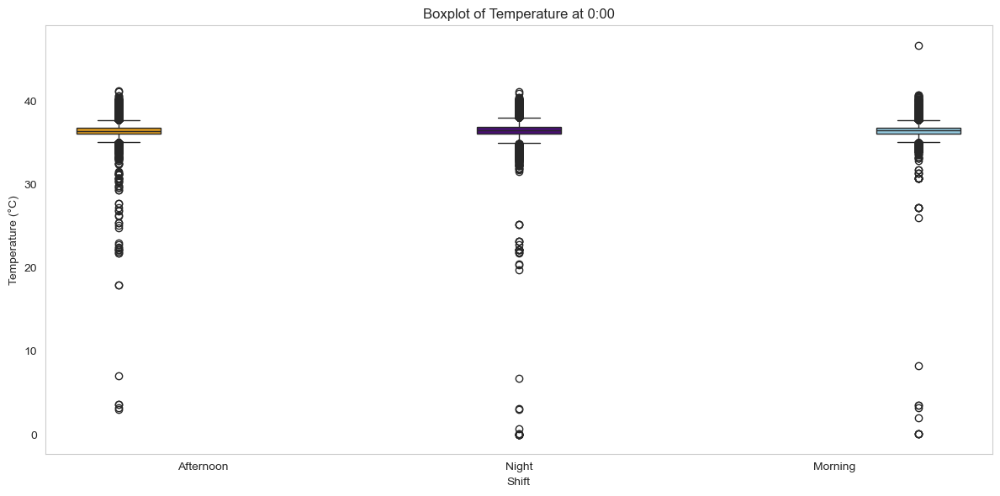

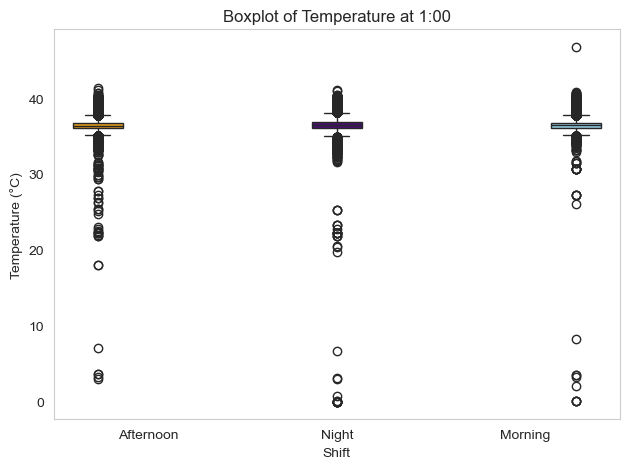

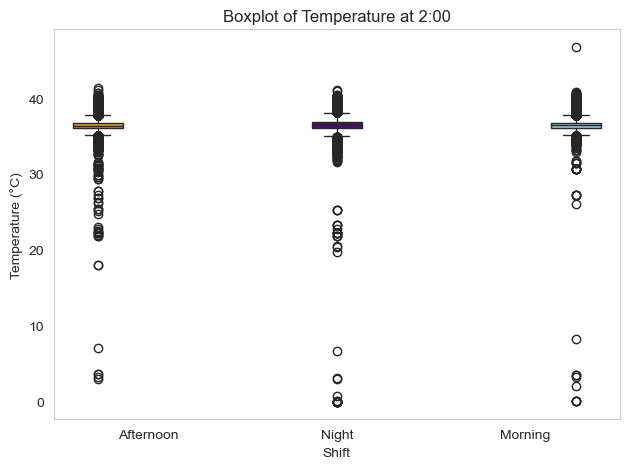

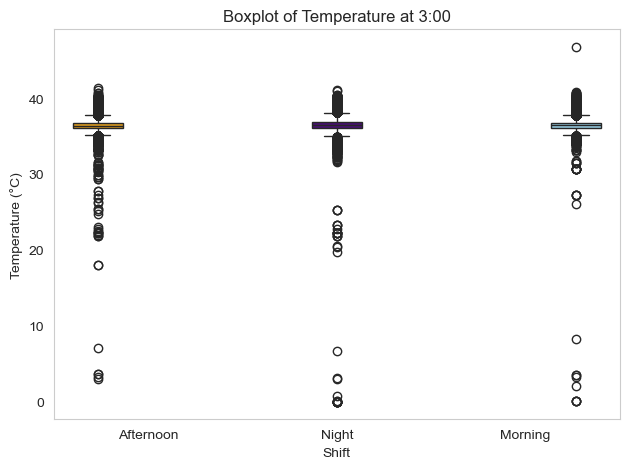

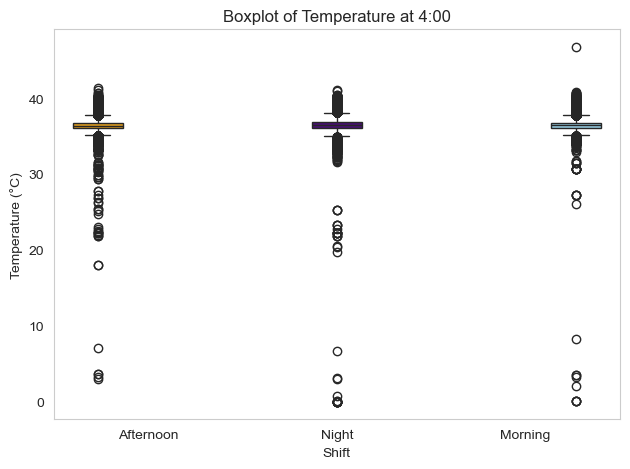

...

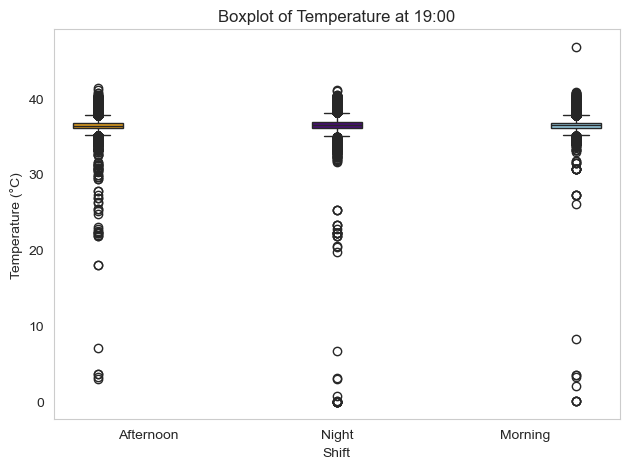

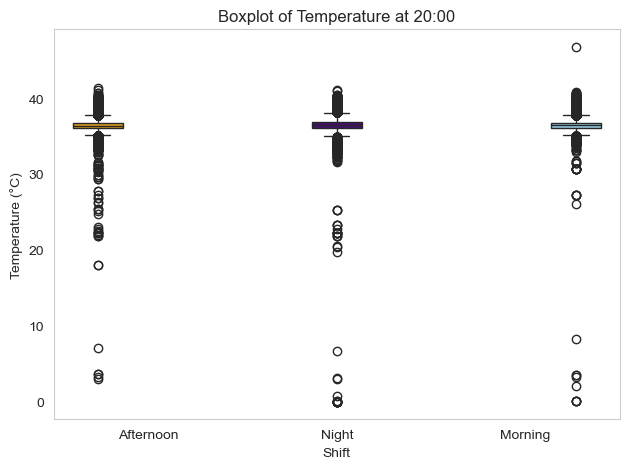

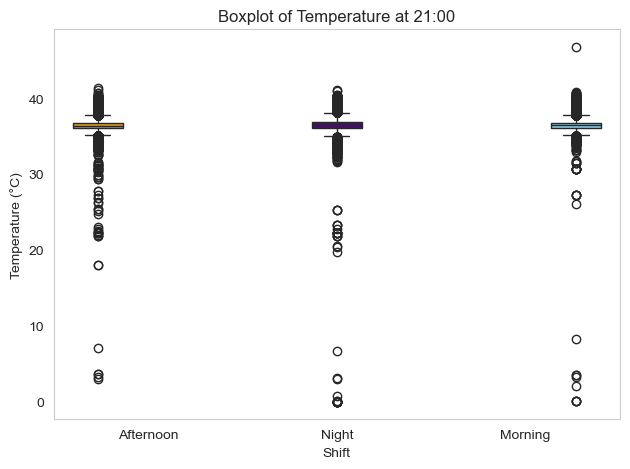

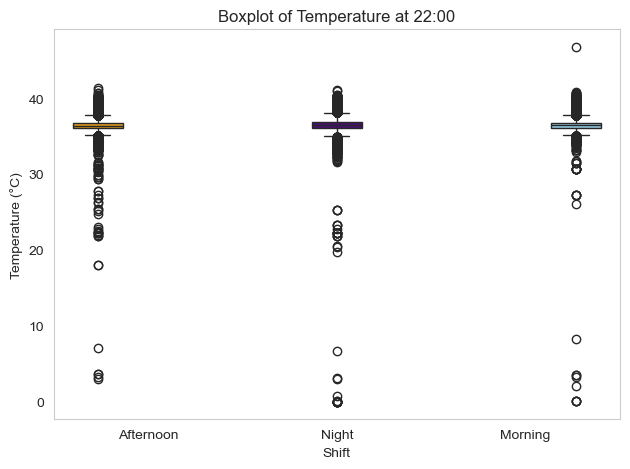

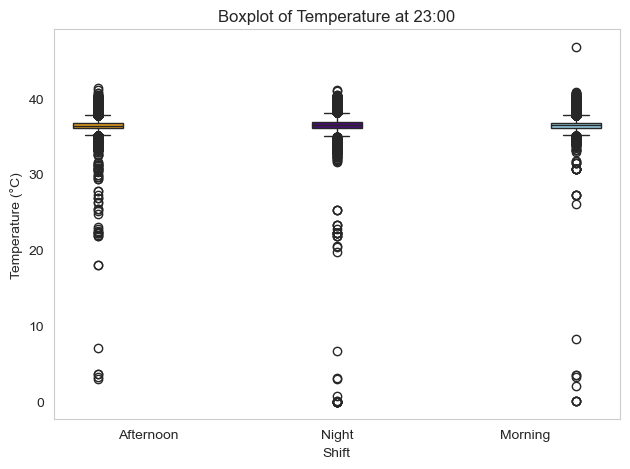

In [190]:
# Create a figure
plt.figure(figsize=(12, 6))

# Loop through each hour of the day to create boxplots for each shift
for hour in range(24):
    # Filter the DataFrame for the current hour
    hour_data = df[df['hour'] == hour]

    # Create a boxplot for the current hour
    sns.boxplot(x='Shift', y=df['MEAS_VALUE'], data=df, hue='Shift',
                palette={'Morning': '#87CEEB', 'Afternoon': '#FFA500', 'Night': '#4B0082'},
                dodge=True)

    # Set titles and labels for each subplot
    plt.title(f'Boxplot of Temperature at {hour}:00')
    plt.xlabel('Shift')
    plt.ylabel('Temperature (°C)')

    # Show grid
    plt.grid(axis='y')

    # Show the plot for the current hour
    plt.tight_layout()
    plt.show()

In [343]:
df_filtered = dataset_v1.copy()

In [329]:
multiplier = 0

# Calculate Q1 (25th percentile) and Q3 (75th percentile) for MEAS_VALUE
Q1 = df['MEAS_VALUE'].quantile(0.25)
Q3 = df['MEAS_VALUE'].quantile(0.75)

# Calculate the IQR
IQR = Q3 - Q1

# Determine the upper and lower bounds
lower_bound = Q1 - multiplier * IQR
upper_bound = Q3 + multiplier * IQR

# Filter the dataframe to remove outliers
df_filtered = df[(df['MEAS_VALUE'] >= lower_bound) & (df['MEAS_VALUE'] <= upper_bound)]

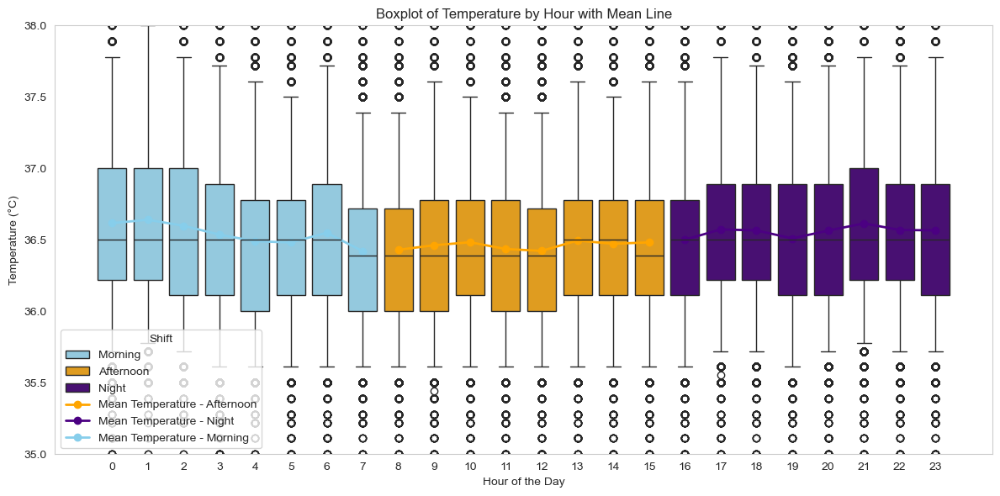

In [344]:
# Print or use df_filtered for further analysis or plotting
# print(df_filtered)

# Create a figure
plt.figure(figsize=(12, 6))

df_filtered = df_filtered.dropna(subset=['MEAS_VALUE'])
# Ensure 'hour' column has valid integers
df_filtered['hour'] = df_filtered['hour'].round().astype(int)

# Safely round temperature values using .loc[]
df_filtered.loc[:, 'MEAS_VALUE'] = df_filtered['MEAS_VALUE'].round(3)

# Create a boxplot
sns.boxplot(x='hour', y='MEAS_VALUE', hue='Shift', data=df_filtered,
            palette={'Morning': '#87CEEB', 'Afternoon': '#FFA500', 'Night': '#4B0082'},
            dodge=False, whis=[5, 95]) # Dodge=False to overlay boxplots

# Overlay a line plot for each shift
for shift in df_filtered['Shift'].unique():
    shift_data = df_filtered[df_filtered['Shift'] == shift].groupby('hour')['MEAS_VALUE'].mean()
    plt.plot(shift_data.index, shift_data.values, marker='o', linewidth=2,
             label=f'Mean Temperature - {shift}', color={'Morning': '#87CEEB',
                                                         'Afternoon': '#FFA500',
      
                                                       'Night': '#4B0082'}[shift])

# Set a fixed y-axis range to ensure consistency
plt.ylim(35, 38)

# Adding titles and labels
plt.title('Boxplot of Temperature by Hour with Mean Line')
plt.xlabel('Hour of the Day')
plt.ylabel('Temperature (°C)')

# Show legend
plt.legend(title='Shift', loc='lower left')

# Show grid
plt.grid(axis='y')

# Show the plot
plt.tight_layout()
plt.show()

In [154]:
# Remove NaN values from the temperature column
df = df.dropna(subset=['MEAS_VALUE'])

# Create a figure
fig = go.Figure()

# Calculate histogram data
hist, bins = np.histogram(df['MEAS_VALUE'], bins=10, density=True)

# Calculate the bin centers for plotting
bin_centers = 0.5 * (bins[1:] + bins[:-1])

# Add histogram for density estimation
fig.add_trace(go.Bar(
    x=bin_centers,
    y=hist,
    name='Temperature Density',
    opacity=0.5,
    width=np.diff(bins),  # Set bar width to the bin width
))

# Update layout with x-axis and y-axis limits
max_density = hist.max() if hist.size > 0 else 0  # Get the maximum density value

# Ensure the maximum density is not NaN and set y-axis limit accordingly
fig.update_layout(
    title='Temperature Density Estimation',
    xaxis_title='Temperature (°C)',
    yaxis_title='Density',
    xaxis=dict(range=[30, 45]),  # Set x-axis limits from 30 to 45
    yaxis=dict(range=[0, max_density * 1.2]),  # Set y-axis max slightly higher than max density
    bargap=0.2  # Space between bars
)

# Show the plot
fig.show()

In [155]:
# Check for NaN values and handle them
df = df.dropna(subset=['MEAS_VALUE'])

# Create a figure
fig = go.Figure()

# Calculate histogram data
hist, bins = np.histogram(df['MEAS_VALUE'], bins=10, density=True)

# Calculate the bin centers for plotting
bin_centers = 0.5 * (bins[1:] + bins[:-1])

# Add histogram for density estimation
fig.add_trace(go.Histogram(
    x=df['MEAS_VALUE'],
    name='Temperature Density',
    opacity=0.5,
    histnorm='probability density',  # Normalizes to probability density
    marker=dict(line=dict(width=1))
))

# Update layout with x-axis and y-axis limits
max_density = hist.max() if hist.size > 0 else 0  # Get the maximum density value
print("Max density:", max_density)

fig.update_layout(
    title='Temperature Density Estimation',
    xaxis_title='Temperature (°C)',
    yaxis_title='Density',
    xaxis=dict(range=[30, 45]),
    yaxis=dict(range=[0,  max_density * 1.2]),
    height = 1000# Set y-axis limits to your desired range
)

# Show the plot
#fig.show()

Max density: 0.19535939393692897


In [135]:
df['MEAS_VALUE'] = df['MEAS_VALUE'].dropna()

In [136]:
df['MEAS_VALUE'].isnull().sum()

1295

In [138]:
df = df.dropna(subset=['MEAS_VALUE'])

# Check for NaN values after dropping
print("NaN values after dropping:", df['MEAS_VALUE'].isnull().sum())

NaN values after dropping: 0


In [114]:
# Create a figure
fig = go.Figure()

# Loop through shifts to create histograms
for shift in df['Shift'].unique():
    # Filter data for the current shift
    shift_data = df[df['Shift'] == shift]

    # Add histogram for the temperature values
    fig.add_trace(go.Histogram(
        x=shift_data['hour'],
        y=shift_data['MEAS_VALUE'],
        name=shift,
        opacity=0.5,
        histfunc='sum',  # Aggregate temperatures for the histogram
        xbins=dict(
            start=0,   # Start of the bins
            end=23,    # End of the bins (24 hours)
            size=1     # Bin width
        )
    ))

# Update layout with axis limits and specified figure size
fig.update_layout(
    title='Temperature Distribution by Hour of the Day',
    xaxis_title='Hour of the Day',
    yaxis_title='Total Temperature (°C)',  # Y-axis reflects total temperature
    barmode='overlay',  # Overlay histograms for different shifts
    width=500,   # Set the width of the figure
    height=1000  # Set the height of the figure
)

# Show the plot
fig.show()

In [150]:
plt.close()
# Apply the function to the hour column
df['Shift'] = df['hour'].apply(assign_shift)

# Create a figure
fig = go.Figure()

# Loop through shifts to create bar traces
for shift in df['Shift'].unique():
    # Filter data for the current shift
    shift_data = df[df['Shift'] == shift]

    # Add bar plot for temperature values
    fig.add_trace(go.Bar(
        x=shift_data['hour'],
        y=shift_data['MEAS_VALUE'],
        name=shift,
        opacity=1
    ))

# Update layout with axis limits and specified figure size
fig.update_layout(
    title='Temperature by Hour of the Day',
    xaxis_title='Hour of the Day',
    yaxis_title='Temperature (°C)',
    barmode='group',  # Group bars for different shifts
    width=500,   # Set the width of the figure
    height=1000  # Set the height of the figure
)

# Show the plot
fig.show()

In [116]:
# Create a figure
fig = go.Figure()

# Loop through shifts to create histograms and KDE lines
for shift, hours in shifts.items():
    # Create histogram
    hist_data = np.histogram(hours, bins=24, density=True)
    x_hist = (hist_data[1][:-1] + hist_data[1][1:]) / 2  # Bin centers
    y_hist = hist_data[0]

    fig.add_trace(go.Bar(
        x=x_hist,
        y=y_hist,
        name=shift,
        opacity=0.3,
        #marker_color='skyblue' if shift == 'Morning' else ('orange' if shift == 'Afternoon' else 'lightgreen'),
        showlegend=True
    ))

    # Fit a KDE line using scipy
    kde = gaussian_kde(hours)
    x_kde = np.linspace(0, 23, 100)
    y_kde = kde(x_kde)

    # Add KDE line
    fig.add_trace(go.Scatter(
        x=x_kde,
        y=y_kde,
        mode='lines',
        name=f'{shift} KDE',
        line=dict(width=2, dash='dash'),
        marker=dict(color='blue' if shift == 'Morning' else ('orange' if shift == 'Afternoon' else 'green'))
    ))

# Update layout
fig.update_layout(
    title='Interactive Histogram of Shifts Distribution with KDE Lines',
    xaxis_title='Hour of the Day',
    yaxis_title='Density',
    barmode='overlay'
)

# Show the plot
fig.show()

In [117]:
# Group by 'Shift' and calculate min, median, and max
shift_stats = df.groupby('Shift')['hour'].agg(['min', 'median', 'max']).reset_index()

# Display the results
print(shift_stats)

       Shift  min  median  max
0  Afternoon    8    12.0   15
1    Morning    0     4.0    7
2      Night   16    19.0   23


In [ ]:

# Create numpy arrays with time ranges
within_30 = (out_df["predicted"] < out_df["actual"] + 30) & (out_df["predicted"] > out_df["actual"] - 30)
within_60 = (out_df["predicted"] < out_df["actual"] + 60) & (out_df["predicted"] > out_df["actual"] - 60)
within_90 = (out_df["predicted"] < out_df["actual"] + 90) & (out_df["predicted"] > out_df["actual"] - 90)
above_90 = (out_df["predicted"] > out_df["actual"] + 90) | (out_df["predicted"] < out_df["actual"] - 90)

only_30 = within_30
only_60 = within_60 & ~within_30
only_90 = within_90 & ~within_60 & ~within_30
more_than_90 = above_90 & ~within_90 & ~within_60 & ~within_30

out_df[["only_30", "only_60", "only_90", "above_90"]] = np.column_stack([only_30, only_60, only_90])

# Plot
plt.close()
plt.figure(figsize=(15,15))
#for col in ["only_30", "only_60", "only_90"]:
#  subset = out_df[out_df[col]==True][["actual", "predicted"]]
 #   plt.hist(data[col], alpha=0.17)

#plt.xlim(0, 300)
#plt.ylim(0, 300) 

# Create a bar plot for each shift
plt.bar(shift_counts.index, shift_counts.values, color=['skyblue', 'orange', 'lightgreen'], alpha=0.7)

#plt.xlabel('Actual time (minutes)')
#plt.ylabel('Predicted time (minutes)')
#plt.title('XGBoost Results')
plt.legend(title='Time Range (minutes)', labels = ["30", "60", "90"])

plt.show()

In [17]:
dataset_v1.dtypes

PAT_ENC_CSN_ID             int64
ENTRY_TIME                object
MEAS_VALUE               float64
entry_dt          datetime64[ns]
dtype: object

In [12]:
# Rename columns
dataset_v1.rename(columns={'ï»¿PAT_ENC_CSN_ID': 'PAT_ENC_CSN_ID'}, inplace=True)

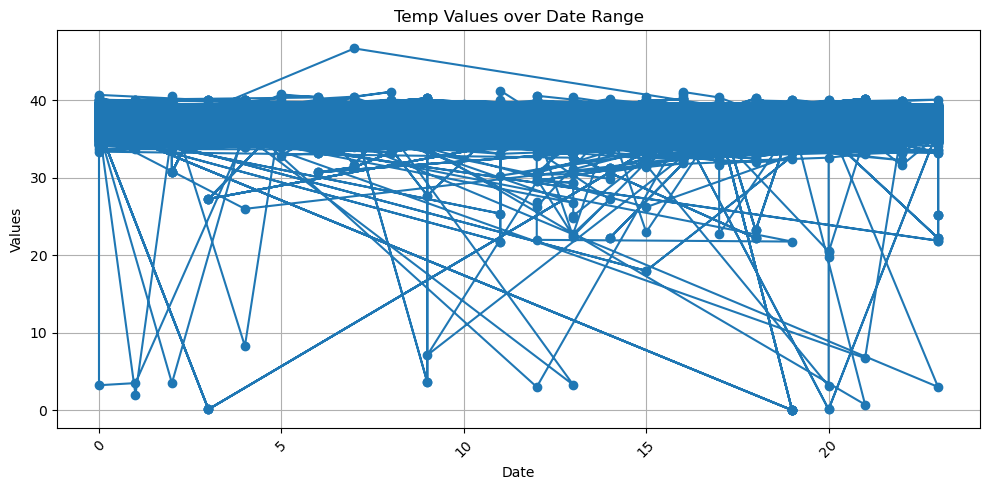

In [48]:
plt.figure(figsize=(10, 5))
plt.plot(dataset_v1['hour'], dataset_v1['MEAS_VALUE'], marker='o')

# Resample to daily data (you can use 'mean' or 'sum' based on your needs)
#daily_data = dataset_v1.resample('D', on='entry_dt').mean()


# Formatting the plot
plt.title('Temp Values over Date Range')
plt.xlabel('Date')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.grid()

# Show the plot
plt.tight_layout()
plt.show()

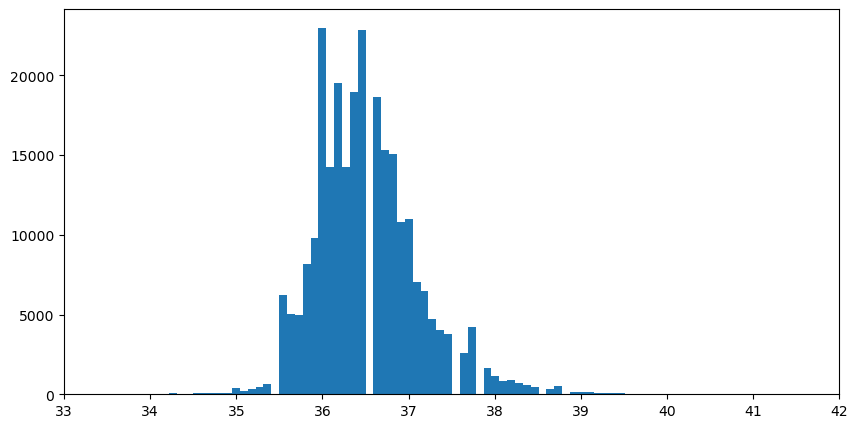

In [44]:
plt.close()
plt.figure(figsize=(10, 5))
plt.hist(dataset_v1['MEAS_VALUE'], bins='sqrt')
#dataset_v1['MEAS_VALUE'].plot.kde()
plt.xlim(33, 42)
plt.show()